# Image Embedding

In [75]:
from PIL import Image
import numpy as np

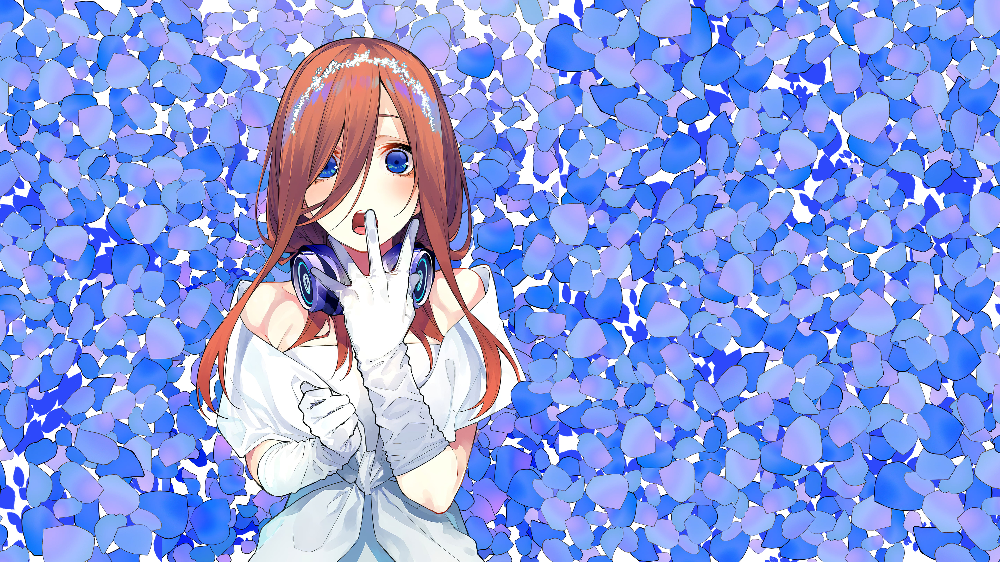

In [76]:
img=Image.open("miku.jpg").convert("RGB")
img

In [77]:
# img=Image.open("lena_gray.gif").convert("L")
# img

In [78]:
img.mode

'RGB'

In [79]:
nparr=np.array(img)
nparr

array([[[ 33, 107, 254],
        [ 34, 108, 255],
        [ 34, 108, 255],
        ...,
        [173, 171, 254],
        [173, 171, 255],
        [171, 172, 254]],

       [[ 35, 107, 254],
        [ 36, 108, 255],
        [ 35, 107, 254],
        ...,
        [174, 170, 254],
        [175, 171, 255],
        [174, 170, 255]],

       [[ 33, 107, 254],
        [ 35, 107, 254],
        [ 32, 106, 253],
        ...,
        [171, 172, 252],
        [172, 173, 255],
        [173, 170, 255]],

       ...,

       [[152, 156, 253],
        [153, 156, 253],
        [154, 157, 254],
        ...,
        [ 74, 118, 215],
        [ 70, 131, 246],
        [ 59, 124, 242]],

       [[154, 157, 254],
        [154, 157, 254],
        [154, 157, 254],
        ...,
        [ 77, 128, 235],
        [ 63, 127, 250],
        [ 64, 128, 251]],

       [[154, 157, 254],
        [154, 157, 254],
        [154, 157, 254],
        ...,
        [ 68, 118, 243],
        [ 61, 121, 253],
        [ 60, 124, 250]]

In [80]:
nparr.shape

(2160, 3840, 3)

In [81]:
def getblocks(image: np.ndarray, blockshape: tuple, moveAxis: bool = True) -> np.ndarray:
    '''
    takes the array of image in grey= 2D and in RGB = 3D
    takes the numpy array and converts it the the blocks in the fastest way
    '''
    if len(image.shape) == 2:
        mode = "grey"
        image = image.reshape(*image.shape, 1)
    else:
        mode = "color"

    img_height, img_width, channels = image.shape
    tile_height, tile_width = blockshape

    if img_height % tile_height != 0 or img_width % tile_width != 0:
        print("warning: Block size is not fit for the image!")

    tiled_array = image.reshape(
        img_height//tile_height, tile_height, img_width//tile_width, tile_width, channels)
    tiled_array = tiled_array.swapaxes(1, 2)

    if moveAxis:
        tiled_array = tiled_array.reshape(-1,
                                          *(tile_height, tile_width, channels))
        tiled_array = np.moveaxis(tiled_array, source=len(
            tiled_array.shape)-1, destination=1)

    return tiled_array


def combineBlocks(tiled_array: np.ndarray, imageshape: tuple, blockshape: tuple, movedAxis: bool = True) -> np.ndarray:

    if len(imageshape) == 2:
        mode = "grey"
        imageshape = *imageshape, 1
    else:
        mode = "color"

    img_height, img_width, channels = imageshape
    tile_height, tile_width = blockshape

    if movedAxis:
        image = tiled_array.copy()
        image = image.reshape(img_height//tile_height, tile_height,
                              img_width//tile_width, tile_width, channels)
        swapaxisShape = list(image.shape)
        swapaxisShape[1], swapaxisShape[2] = swapaxisShape[2], swapaxisShape[1]
        image = image.reshape(swapaxisShape)
        image = image.swapaxes(1, 2)
    else:
        image = tiled_array
        # IDK have completed this else case. Btw we aren't using this case lol :)

    return image.reshape(imageshape)


In [82]:
%timeit getblocks(nparr,(2,2), True)

46.2 ms ± 15.1 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [83]:
blocksize=(4,2)

In [84]:
blocks=getblocks(nparr, blocksize, True)
blocks

array([[[[ 33,  34],
         [ 35,  36],
         [ 33,  35],
         [ 33,  32]],

        [[107, 108],
         [107, 108],
         [107, 107],
         [107, 106]],

        [[254, 255],
         [254, 255],
         [254, 254],
         [254, 253]]],


       [[[ 34,  32],
         [ 35,  34],
         [ 32,  33],
         [ 29,  28]],

        [[108, 106],
         [107, 106],
         [106, 107],
         [108, 109]],

        [[255, 253],
         [254, 253],
         [253, 254],
         [253, 253]]],


       [[[ 31,  31],
         [ 32,  34],
         [ 32,  32],
         [ 28,  29]],

        [[107, 107],
         [106, 106],
         [106, 106],
         [109, 108]],

        [[253, 253],
         [253, 253],
         [253, 253],
         [253, 253]]],


       ...,


       [[[132,   7],
         [ 62,   1],
         [  8,   0],
         [  1,   0]],

        [[125,   7],
         [ 51,   4],
         [  6,   7],
         [  0,   8]],

        [[159,  35],
         [ 94

In [85]:
blocks.shape


(1036800, 3, 4, 2)

In [86]:
blocks[0][0]


array([[33, 34],
       [35, 36],
       [33, 35],
       [33, 32]], dtype=uint8)

## PSNR

In [87]:
from math import log10, sqrt

In [88]:
def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

In [89]:
# print(f"PSNR value is {value} dB")
PSNR(nparr, nparr)

100

In [90]:
avgblock=blocks.copy()

In [91]:
avgblock[0][0]

array([[33, 34],
       [35, 36],
       [33, 35],
       [33, 32]], dtype=uint8)

In [92]:
avgblock[0][0]

array([[33, 34],
       [35, 36],
       [33, 35],
       [33, 32]], dtype=uint8)

In [93]:
# for i in range(avgblock.shape[0]):
#     avgblock[i][0][:] = int(avgblock[i][0].mean())
#     avgblock[i][1][:] = int(avgblock[i][1].mean())
#     avgblock[i][2][:] = int(avgblock[i][2].mean())


In [94]:
# avgblock[0][0][0]=69
# avgblock[2][0][0]=69

In [95]:
avgimage=combineBlocks(avgblock, nparr.shape, blocksize)

In [96]:
avgimage.shape

(2160, 3840, 3)

In [97]:
avgimage

array([[[ 33,  34,  35],
        [ 36,  33,  35],
        [ 34,  32,  35],
        ...,
        [174, 173, 171],
        [173, 171, 175],
        [174, 172, 173]],

       [[ 33,  32, 107],
        [108, 107, 108],
        [ 29,  28, 108],
        ...,
        [171, 172, 170],
        [177, 174, 171],
        [172, 171, 170]],

       [[107, 107, 107],
        [106, 254, 255],
        [106, 107, 108],
        ...,
        [170, 252, 254],
        [173, 170, 172],
        [170, 255, 254]],

       ...,

       [[154, 154, 156],
        [156, 156, 156],
        [154, 157, 156],
        ...,
        [ 90,  21, 118],
        [ 61,  60, 136],
        [122, 131, 124]],

       [[157, 157, 157],
        [157, 255, 255],
        [157, 157, 157],
        ...,
        [118,  56, 177],
        [127, 128, 121],
        [124, 245, 239]],

       [[253, 253, 254],
        [254, 254, 254],
        [254, 255, 254],
        ...,
        [235, 200, 243],
        [246, 242, 250],
        [251, 253, 250]]

In [98]:
(avgimage.reshape(-1)==nparr.reshape(-1)).all()

False

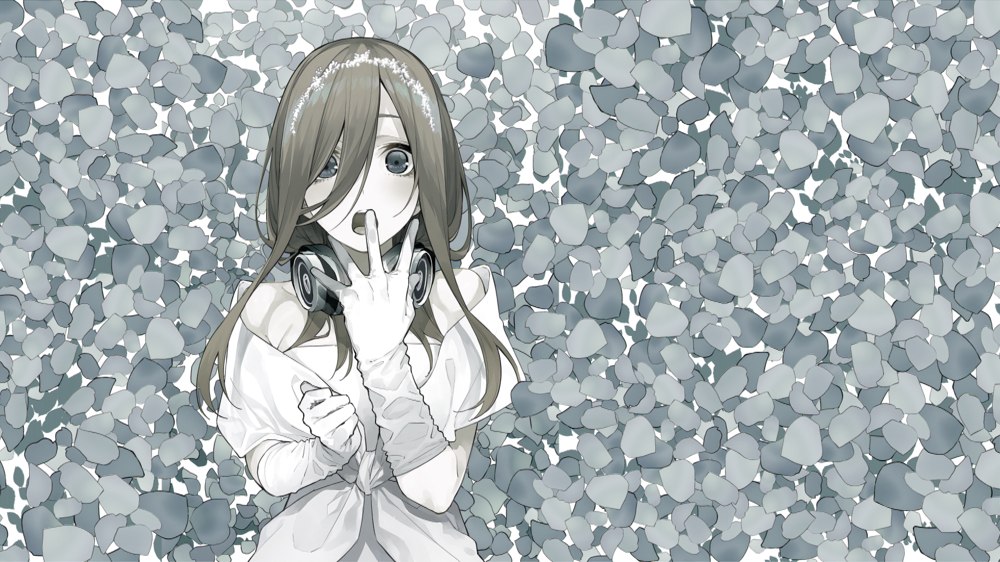

In [99]:
Image.fromarray(avgimage, 'RGB')

In [100]:
PSNR(nparr,avgimage)

29.98510981957957

29.810711022024247 psnr for 2x4
29.83055903916751 psnr for 4x2

In [101]:
avgimage

array([[[ 33,  34,  35],
        [ 36,  33,  35],
        [ 34,  32,  35],
        ...,
        [174, 173, 171],
        [173, 171, 175],
        [174, 172, 173]],

       [[ 33,  32, 107],
        [108, 107, 108],
        [ 29,  28, 108],
        ...,
        [171, 172, 170],
        [177, 174, 171],
        [172, 171, 170]],

       [[107, 107, 107],
        [106, 254, 255],
        [106, 107, 108],
        ...,
        [170, 252, 254],
        [173, 170, 172],
        [170, 255, 254]],

       ...,

       [[154, 154, 156],
        [156, 156, 156],
        [154, 157, 156],
        ...,
        [ 90,  21, 118],
        [ 61,  60, 136],
        [122, 131, 124]],

       [[157, 157, 157],
        [157, 255, 255],
        [157, 157, 157],
        ...,
        [118,  56, 177],
        [127, 128, 121],
        [124, 245, 239]],

       [[253, 253, 254],
        [254, 254, 254],
        [254, 255, 254],
        ...,
        [235, 200, 243],
        [246, 242, 250],
        [251, 253, 250]]

for the 4x2 PSNR

In [102]:
blocksize=(4,2)

In [103]:
blocks = nparr.reshape(
    (int(imagedim[0]/blocksize[0]), int(imagedim[1]/blocksize[1]), blocksize[0], blocksize[1]))
np.set_printoptions(threshold=np.inf)
print(nparr.reshape(-1))

NameError: name 'imagedim' is not defined

In [ ]:
blocks.shape


(128, 256, 4, 2)

In [ ]:
avgblock=blocks.copy()

In [ ]:
for i in range(avgblock.shape[0]):
    for j in range(avgblock.shape[1]):
        avgblock[i][j][:] = int(avgblock[i][j].mean())


In [ ]:
avgblock[0][0]

array([[161, 161],
       [161, 161],
       [161, 161],
       [161, 161]], dtype=uint8)

In [ ]:
image2=avgblock.reshape((512,512))
image2

array([[161, 161, 161, ..., 157, 157, 157],
       [161, 161, 161, ..., 157, 157, 157],
       [161, 161, 161, ..., 157, 157, 157],
       ...,
       [ 47,  47,  47, ...,  93,  93,  93],
       [ 49,  49,  49, ..., 100, 100, 100],
       [ 51,  51,  51, ..., 100, 100, 100]], dtype=uint8)

In [ ]:
PSNR(nparr,image2)

31.91000223219273

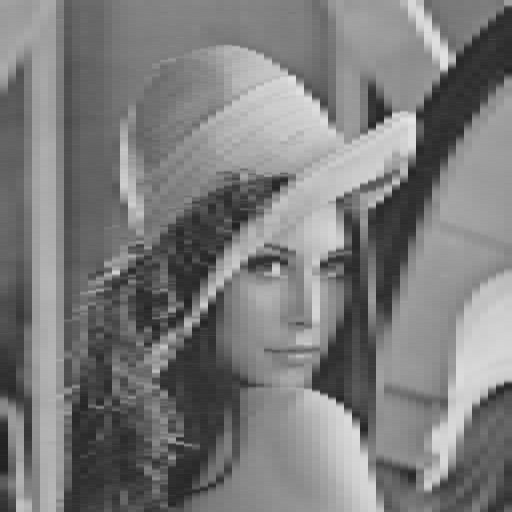

In [ ]:
Image.fromarray(image2, 'L')